In [61]:
import numpy as np
import pandas as pd
import nltk
import matplotlib.pyplot as plt
import kagglehub
import string
from wordcloud import WordCloud
from wordcloud import WordCloud, STOPWORDS
from gensim.models import Word2Vec, FastText
from sklearn.decomposition import PCA
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score, confusion_matrix , classification_report
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

In [2]:
def swap_columns(df, col1, col2):
    col_list = list(df.columns)
    x, y = col_list.index(col1), col_list.index(col2)
    col_list[y], col_list[x] = col_list[x], col_list[y]
    df = df[col_list]
    return df

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
dataset = pd.read_csv('/content/drive/MyDrive/CS410/spam_ham_dataset.csv')

In [5]:
dataset.head()

,Unnamed: 0,label,text,label_num
0,605,ham,Subject: enron methanol ; meter # : 988291\r\n...,0
1,2349,ham,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,3624,ham,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,4685,spam,"Subject: photoshop , windows , office . cheap ...",1
4,2030,ham,Subject: re : indian springs\r\nthis deal is t...,0


In [6]:
c = dataset['label'].value_counts()
c

,count
label,
ham,3672
spam,1499


In [7]:
dataset = dataset.drop('Unnamed: 0', axis=1)
dataset = dataset.drop('label', axis=1)
dataset.head()

,text,label_num
0,Subject: enron methanol ; meter # : 988291\r\n...,0
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,"Subject: photoshop , windows , office . cheap ...",1
4,Subject: re : indian springs\r\nthis deal is t...,0


In [8]:
subjects = []
for i in range(len(dataset)):
    ln = dataset["text"][i]
    line = ""
    for i in ln:
        if(i == '\r'):
            break
        line = line + i
    line = line.replace("Subject" , "")
    subjects.append(line)

In [9]:
dataset['Subject'] = subjects
dataset.head()

,text,label_num,Subject
0,Subject: enron methanol ; meter # : 988291\r\n...,0,: enron methanol ; meter # : 988291
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",0,": hpl nom for january 9 , 2001"
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0,: neon retreat
3,"Subject: photoshop , windows , office . cheap ...",1,": photoshop , windows , office . cheap . main ..."
4,Subject: re : indian springs\r\nthis deal is t...,0,: re : indian springs


In [10]:
dataset.columns = ['Email_text', 'Labels', 'Email_Subject']
dataset.head()
dataset = swap_columns(dataset, 'Labels', 'Email_Subject')

In [11]:
dataset['Email_Subject'] = dataset['Email_Subject'].str.lower()
dataset['Email_text'] = dataset['Email_text'].str.lower()
dataset.head()

,Email_text,Email_Subject,Labels
0,subject: enron methanol ; meter # : 988291\r\n...,: enron methanol ; meter # : 988291,0
1,"subject: hpl nom for january 9 , 2001\r\n( see...",": hpl nom for january 9 , 2001",0
2,"subject: neon retreat\r\nho ho ho , we ' re ar...",: neon retreat,0
3,"subject: photoshop , windows , office . cheap ...",": photoshop , windows , office . cheap . main ...",1
4,subject: re : indian springs\r\nthis deal is t...,: re : indian springs,0


In [12]:
def remove_punctuations(text):
    for punctuation in string.punctuation:
        text = text.replace(punctuation, '')
    return text

dataset['Email_Subject'] = dataset['Email_Subject'].apply(remove_punctuations)
dataset['Email_text'] = dataset['Email_text'].apply(remove_punctuations)
dataset.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
4,subject re indian springs\r\nthis deal is to ...,re indian springs,0


In [13]:
Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])
Non_Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])

In [14]:
for i in range(len(dataset)):
    if(dataset['Labels'][i] == 0):
        new_row = {'Email_text':dataset['Email_text'][i], 'Email_Subject':dataset['Email_Subject'][i], 'Labels':dataset['Labels'][i]}
        Non_Spam = pd.concat([Non_Spam, pd.DataFrame([new_row])], ignore_index=True)

In [15]:
for i in range(len(dataset)):
    if(dataset['Labels'][i] == 1):
        new_row = {'Email_text':dataset['Email_text'][i], 'Email_Subject':dataset['Email_Subject'][i], 'Labels':dataset['Labels'][i]}
        Spam = pd.concat([Spam, pd.DataFrame([new_row])], ignore_index=True)

In [16]:
Non_Spam.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject re indian springs\r\nthis deal is to ...,re indian springs,0
4,subject ehronline web address change\r\nthis m...,ehronline web address change,0


In [17]:
Spam.head()

,Email_text,Email_Subject,Labels
0,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
1,subject looking for medication we re the bes...,looking for medication we re the best source,1
2,subject vocable rnd word asceticism\r\nvcsc ...,vocable rnd word asceticism,1
3,subject report 01405 \r\nwffur attion brom est...,report 01405,1
4,subject vic odin n ow\r\nberne hotbox carnal...,vic odin n ow,1


In [18]:
more_stopwords = {'re' , 's' , 'subject','hpl','hou','enron'}
STOPWORDS = STOPWORDS.union(more_stopwords)

In [19]:
Subject_corpus_spam = ""
for i in range(len(Spam)):
    Subject_corpus_spam = Subject_corpus_spam + Spam['Email_Subject'][i]

In [20]:
Text_corpus_spam = ""
for i in range(len(Spam)):
    Text_corpus_spam = Text_corpus_spam + Spam['Email_text'][i]

In [21]:
Subject_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Subject_corpus_non_spam = Subject_corpus_non_spam + Non_Spam['Email_Subject'][i]

In [22]:
Text_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Text_corpus_non_spam = Text_corpus_non_spam + Non_Spam['Email_text'][i]

In [24]:
def make_wordcloud(corpus , stopword):
    word_cloud = WordCloud(
            width=3000,
            height=2000,
            random_state=1,
            background_color="black",
            colormap="Pastel1",
            collocations=False,
            stopwords=stopword,
            ).generate(corpus)
    return word_cloud

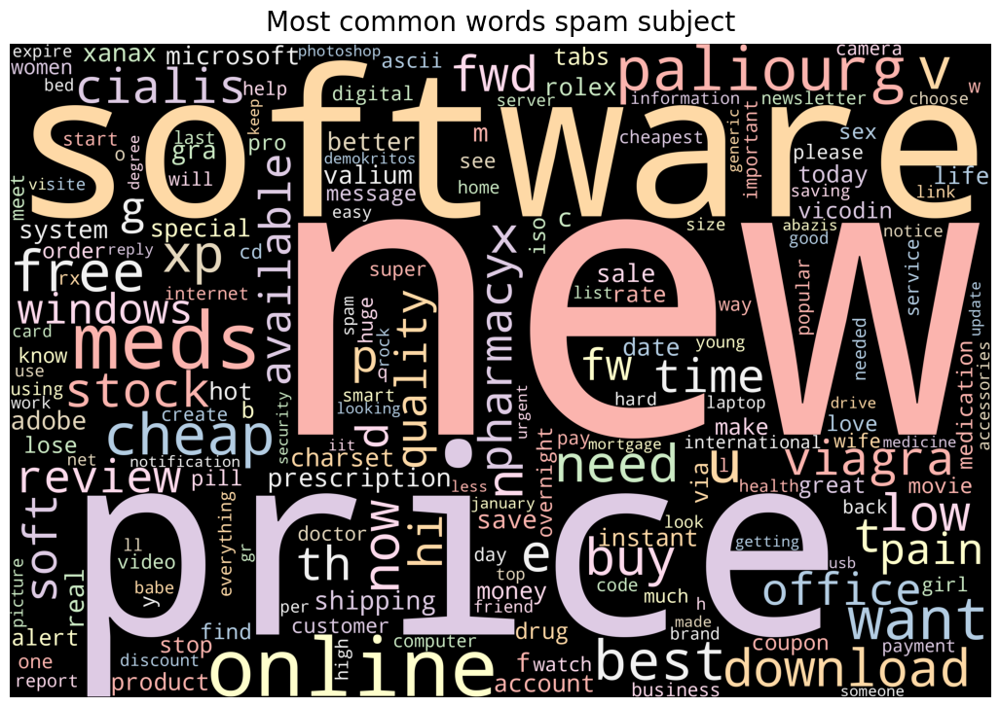

In [25]:
# show the most common words
Spam_Subject_wordcloud = make_wordcloud(Subject_corpus_spam, STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words spam subject", fontdict={'size': 20, 'color': 'black',
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

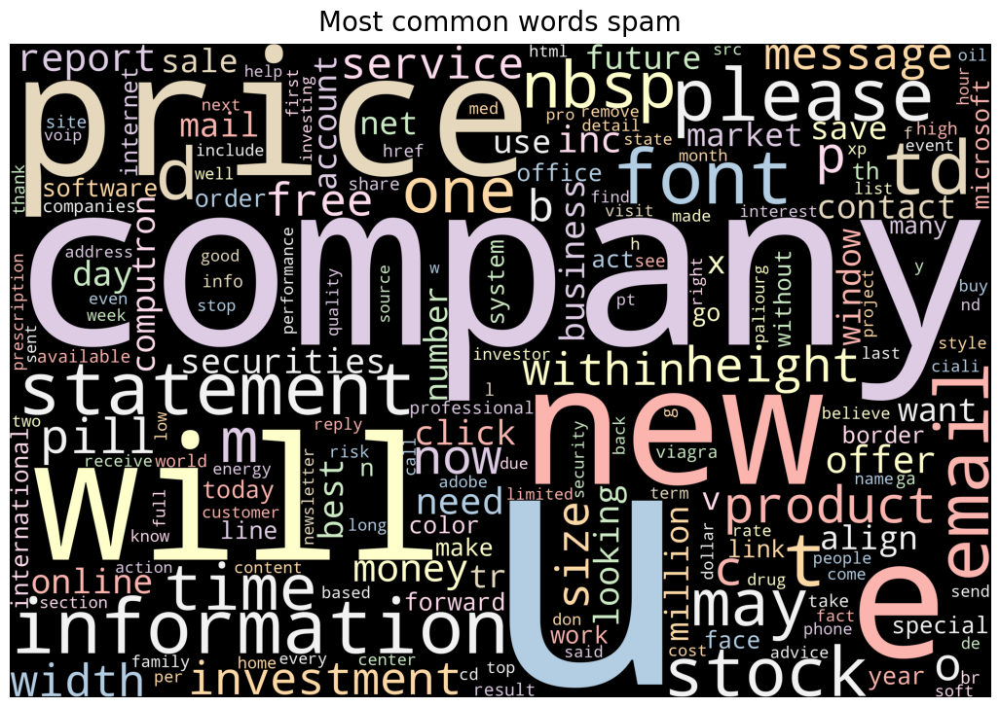

In [26]:
Spam_Text_wordcloud = make_wordcloud(Text_corpus_spam, STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words spam", fontdict={'size': 20, 'color': 'black',
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Text_wordcloud)
plt.axis("off")
plt.show()

In [27]:
Email_text_corpus = []
for line in dataset['Email_text']:
    words = line.split(" ")
    Email_text_corpus.append(words)

In [28]:
model = Word2Vec(Email_text_corpus, min_count=1, vector_size=56)

In [29]:
X = model.wv[model.wv.key_to_index]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
pca_df = pd.DataFrame(result, columns = ['x','y'])

In [30]:
pca_df.head()

,x,y
0,6.835012,-2.780348
1,8.722204,9.010242
2,8.102848,8.949497
3,11.166103,-13.217115
4,6.782290,6.720805


In [31]:
N = 1000000
words = list(model.wv.key_to_index)
fig = go.Figure(data=go.Scattergl(
   x = pca_df['x'],
   y = pca_df['y'],
   mode='markers',
   marker=dict(
       color=np.random.randn(N),
       colorscale='Viridis',
       line_width=1
   ),
   text=words,
   textposition="bottom center"
))

fig.show()

In [62]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

In [63]:
def cost_function(h, y):
    return (-y * np.log(h + 1e-10) - (1 - y) * np.log(1 - h + 1e-10)).mean()

In [64]:
def gradient_descent(X, h, y):
    return np.dot(X.T, (h - y)) / y.shape[0]

In [65]:
def update_weight_loss(weight, learning_rate, gradient):
    return weight - learning_rate * gradient

In [66]:
X = dataset['Email_text']
y = dataset['Labels'].values

In [67]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
vectorizer = CountVectorizer()
X_train = vectorizer.fit_transform(X_train).toarray()
X_test = vectorizer.transform(X_test).toarray()

In [68]:
X_train = torch.tensor(X_train, dtype=torch.float32).cuda()
y_train = torch.tensor(y_train, dtype=torch.float32).cuda()
X_test = torch.tensor(X_test, dtype=torch.float32).cuda()
y_test = torch.tensor(y_test, dtype=torch.float32).cuda()

In [69]:
class LogisticRegression(nn.Module):
    def __init__(self, input_dim):
        super(LogisticRegression, self).__init__()
        self.linear = nn.Linear(input_dim, 1)

    def forward(self, x):
        return torch.sigmoid(self.linear(x))

model = LogisticRegression(X_train.shape[1]).cuda()
criterion = nn.BCELoss()
optimizer = optim.SGD(model.parameters(), lr=0.1)

In [70]:
num_iter = 2000
losses = []

In [71]:
for epoch in range(num_iter):
    model.train()
    optimizer.zero_grad()
    output = model(X_train).squeeze()
    loss = criterion(output, y_train)
    loss.backward()
    optimizer.step()

    # Log Loss
    losses.append(loss.item())
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

Epoch 0, Loss: 0.6871334314346313
Epoch 100, Loss: 0.18426400423049927
Epoch 200, Loss: 0.1408495008945465
Epoch 300, Loss: 0.11898140609264374
Epoch 400, Loss: 0.10505161434412003
Epoch 500, Loss: 0.09512630850076675
Epoch 600, Loss: 0.08757033199071884
Epoch 700, Loss: 0.08155770599842072
Epoch 800, Loss: 0.07661792635917664
Epoch 900, Loss: 0.0724603608250618
Epoch 1000, Loss: 0.06889458000659943
Epoch 1100, Loss: 0.06578980386257172
Epoch 1200, Loss: 0.06305284798145294
Epoch 1300, Loss: 0.06061515212059021
Epoch 1400, Loss: 0.05842500552535057
Epoch 1500, Loss: 0.0564425066113472
Epoch 1600, Loss: 0.05463628098368645
Epoch 1700, Loss: 0.05298126861453056
Epoch 1800, Loss: 0.05145717039704323
Epoch 1900, Loss: 0.05004731938242912


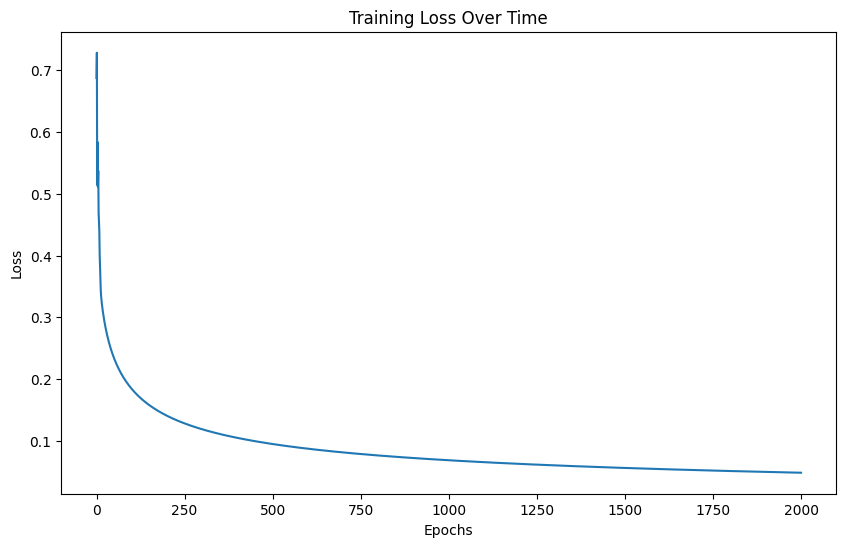

In [72]:
plt.figure(figsize=(10, 6))
plt.plot(losses)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.show()

In [73]:
model.eval()
with torch.no_grad():
    y_pred = model(X_test).squeeze().round()

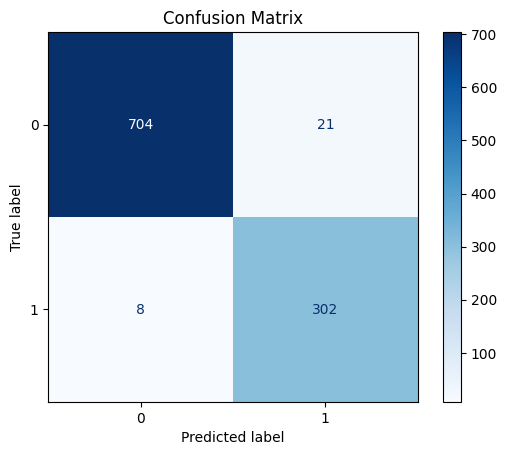

In [74]:
cm = confusion_matrix(y_test.cpu().numpy(), y_pred.cpu().numpy())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()

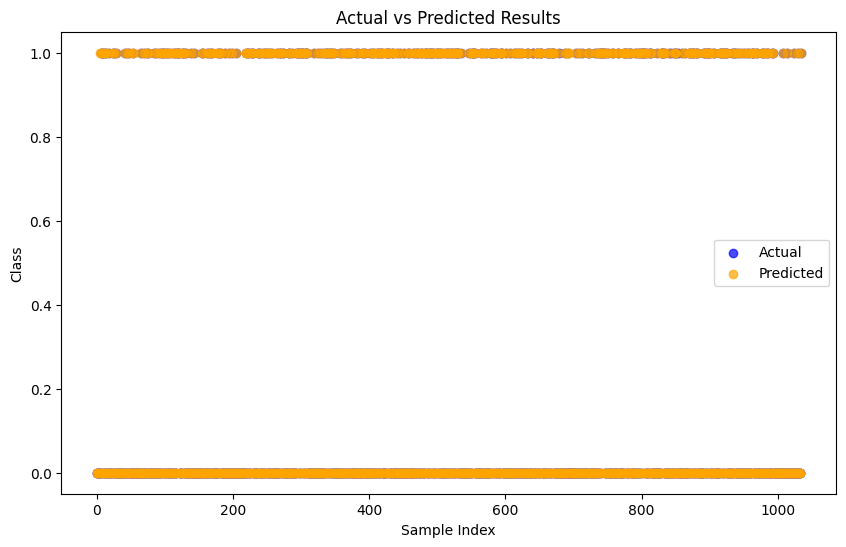

Classification Report:
              precision    recall  f1-score   support

         0.0       0.99      0.97      0.98       725
         1.0       0.93      0.97      0.95       310

    accuracy                           0.97      1035
   macro avg       0.96      0.97      0.97      1035
weighted avg       0.97      0.97      0.97      1035



In [76]:
plt.figure(figsize=(10, 6))
plt.scatter(range(len(y_test)), y_test.cpu(), label='Actual', alpha=0.7, color='blue')
plt.scatter(range(len(y_pred)), y_pred.cpu(), label='Predicted', alpha=0.7, color='orange')
plt.legend()
plt.xlabel('Sample Index')
plt.ylabel('Class')
plt.title('Actual vs Predicted Results')
plt.show()

print('Classification Report:')
print(classification_report(y_test.cpu().numpy(), y_pred.cpu().numpy()))